In [16]:
%matplotlib inline

In [5]:
#from pycocotools.coco import COCO
import glob
import _init_paths
from fast_rcnn.config import cfg
from fast_rcnn.test import im_detect
from fast_rcnn.nms_wrapper import nms
from utils.timer import Timer
import matplotlib.pyplot as plt
import numpy as np
import scipy.io as sio
import caffe, os, sys, cv2
import argparse
from fast_rcnn.config import cfg, cfg_from_file, cfg_from_list
from datasets.config import CLASS_SETS

def _get_ann_file():
        prefix = 'image_info' 
        return os.path.join("/root/data/coco/", 'annotations',
                        prefix + '_' + "test2014" + '.json')

   

In [6]:
CLASSES = CLASS_SETS['NCTU-vehicles']



Loaded network ../models/NCTU-lite/v1_iter_30000.caffemodel
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-tanktruck/images/set00/V000/set00_V000_472.jpg
(720, 960, 3)
Detection took 0.112s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-tanktruck/images/set00/V000/set00_V000_572.jpg
(720, 960, 3)
Detection took 0.062s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-tanktruck/images/set00/V000/set00_V000_575.jpg
(720, 960, 3)
Detection took 0.058s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-tanktruck/images/set00/V000/set00_V000_578.jpg
(720, 960, 3)
Detection took 0.060s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/data-tanktruck/images/set00/V000/set00_V000_584.jpg
(720, 960, 3)
Detection took 0.058s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo fo

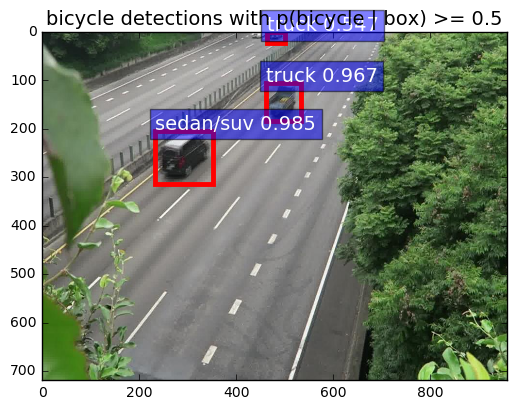

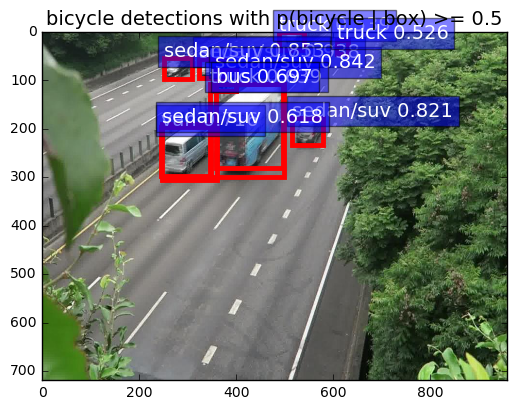

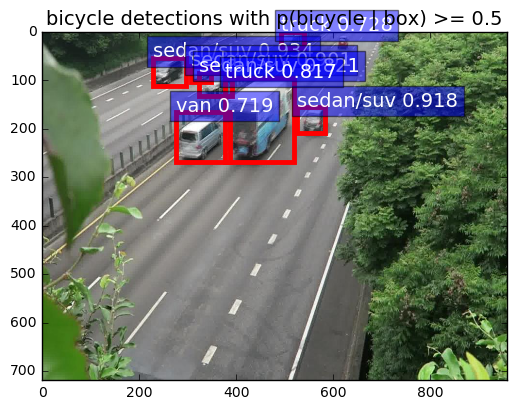

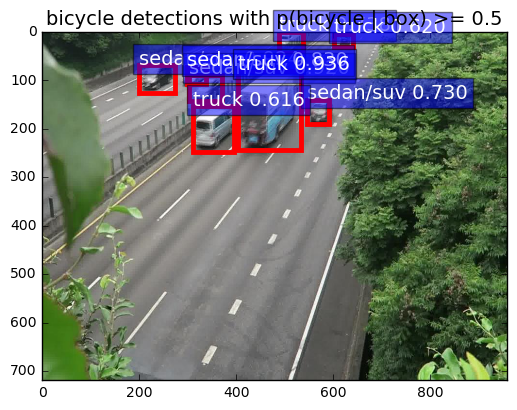

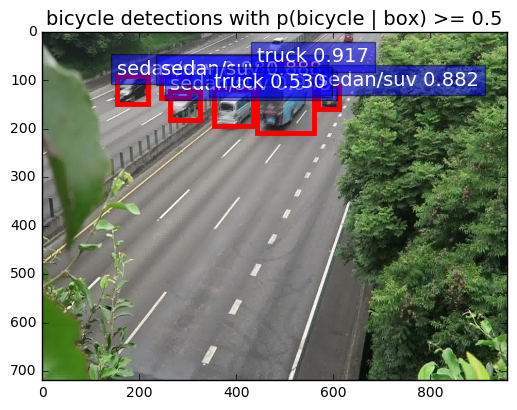

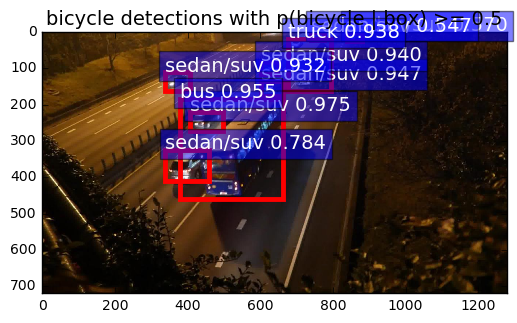

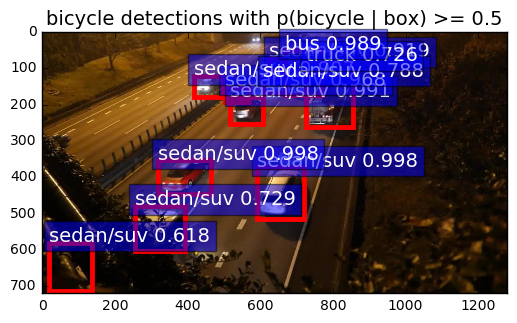

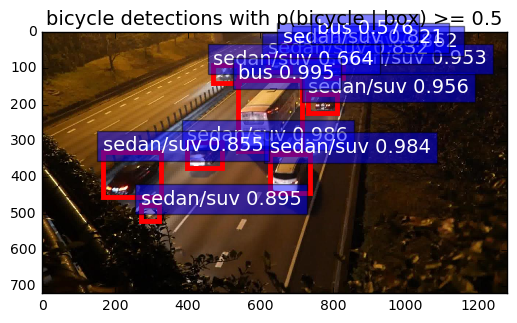

In [24]:


def vis_detections(im, class_names, dets_list, thresh=0.5):
    """Draw detected bounding boxes."""
    im = im[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(6, 6))
    ax.imshow(im, aspect='equal')
    
    for class_name, dets in zip(class_names, dets_list):


        for i in range(len(dets)):
            bbox = dets[i, :4]
            score = dets[i, -1]

            ax.add_patch(
                plt.Rectangle((bbox[0], bbox[1]),
                              bbox[2] - bbox[0],
                              bbox[3] - bbox[1], fill=False,
                              edgecolor='red', linewidth=3.5)
                )
            ax.text(bbox[0], bbox[1] - 2,
                    '{:s} {:.3f}'.format(class_name, score),
                    bbox=dict(facecolor='blue', alpha=0.5),
                    fontsize=14, color='white')

        ax.set_title(('{} detections with '
                      'p({} | box) >= {:.1f}').format(class_name, class_name,
                                                      thresh),
                      fontsize=14)
    #plt.axis('off')
    #plt.tight_layout()
    #plt.draw()

def demo(net, im_file):
    """Detect object classes in an image using pre-computed object proposals."""

    # Load the demo image
   
    im = cv2.imread(im_file)
    print(im.shape)
    #int("Hallo")
    

    # Detect all object classes and regress object bounds
    timer = Timer()
    timer.tic()
    _t = {'im_preproc': Timer(), 'im_net' : Timer(), 'im_postproc': Timer(), 'misc' : Timer()}
    scores, boxes = im_detect(net, im, _t)
   
   
    # Visualize detections for each class
    CONF_THRESH = 0.5
    NMS_THRESH = 0.3
    
    cls_list = []
    dets_list = []
    
    for cls_ind, cls in enumerate(CLASSES[1:]):
        cls_ind += 1 # because we skipped background
        cls_boxes = boxes[:, 4*cls_ind:4*(cls_ind + 1)]   
        
        cls_scores = scores[:, cls_ind]
        
        
        keep = cls_scores > CONF_THRESH
        cls_scores = cls_scores[keep]
        cls_boxes = cls_boxes[keep, :]
        dets = np.hstack((cls_boxes,
                          cls_scores[:, np.newaxis])).astype(np.float32)
        keep = nms(dets, NMS_THRESH)
        dets = dets[keep, :]
        
        
        
        
        
        cls_list.append(cls)
        dets_list.append(dets)
    timer.toc()
    print ('Detection took {:.3f}s for '
       '{:d} object proposals').format(timer.total_time, boxes.shape[0])

        
    vis_detections(im, cls_list, dets_list, thresh=CONF_THRESH)



if __name__ == '__main__':
    #cfg.TEST.HAS_RPN = True
   

    prototxt = "../models/pvanet/lite/seven_test.prototxt"
    caffemodel = "../models/NCTU-lite/v1_iter_30000.caffemodel"
    cfg_from_file("../models/pvanet/cfgs/submit_1019.yml")
    caffe.set_mode_gpu()
    caffe.set_device(0)
    cfg.GPU_ID = 0
    net = caffe.Net(prototxt, caffemodel, caffe.TEST)

    print '\n\nLoaded network {:s}'.format(caffemodel)

    # Warmup on a dummy image
    #m = 128 * np.ones((300, 500, 3), dtype=np.uint8)
    #for i in xrange(2):
        #_t = {'im_preproc': Timer(), 'im_net' : Timer(), 'im_postproc': Timer(), 'misc' : Timer()}
        #_, _= im_detect(net, im, _t)
    
    
    im_names =  ['/root/data/data-tanktruck/images/set00/V000/set00_V000_472.jpg',\
                '/root/data/data-tanktruck/images/set00/V000/set00_V000_572.jpg',\
                '/root/data/data-tanktruck/images/set00/V000/set00_V000_575.jpg',\
                '/root/data/data-tanktruck/images/set00/V000/set00_V000_578.jpg',\
                '/root/data/data-tanktruck/images/set00/V000/set00_V000_584.jpg',\
                '/root/data/data-B2HighwayNight/images/set00/V000/set00_V000_889.jpg',\
                '/root/data/data-B2HighwayNight/images/set00/V000/set00_V000_989.jpg',\
                '/root/data/data-B2HighwayNight/images/set00/V000/set00_V000_1089.jpg']
    

    
    #im_names += glob.glob("/root/data/demo/suitcase/*.jpg")
    #im_names = glob.glob("/root/data/demo/suitcase/*.jpg")

    for im_name in im_names:
        print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
        print 'Demo for data/demo/{}'.format(im_name)
        demo(net, im_name)

    plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_104410.jpg
(232, 301, 3)
Detection took 0.042s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/Ford_Truck_torro_terreno.jpg
(1224, 1632, 3)
Detection took 0.091s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_102350.jpg
(257, 432, 3)
Detection took 0.049s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_103903.jpg
(374, 522, 3)
Detection took 0.053s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/dd6f18b5d3cf1be2fd48c085584341f7--hotrods-dream-cars.jpg
(450, 600, 3)
Detection took 0.047s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/pickup_big/2017-09-19_103629.jpg
(337, 1017, 3)
Detection to

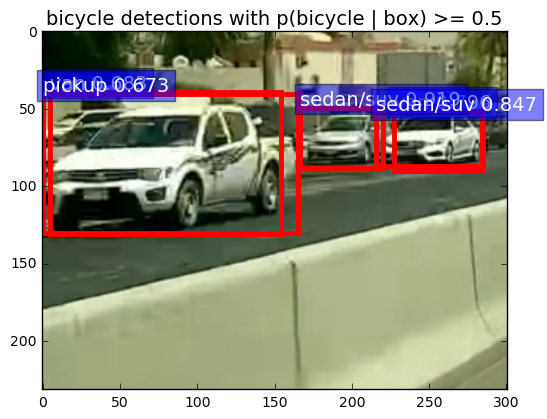

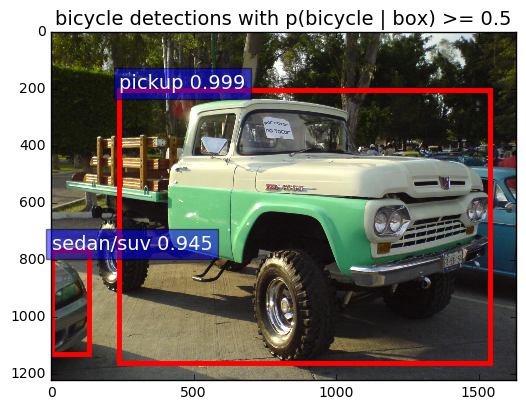

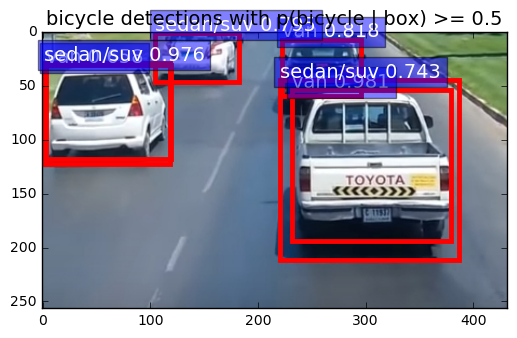

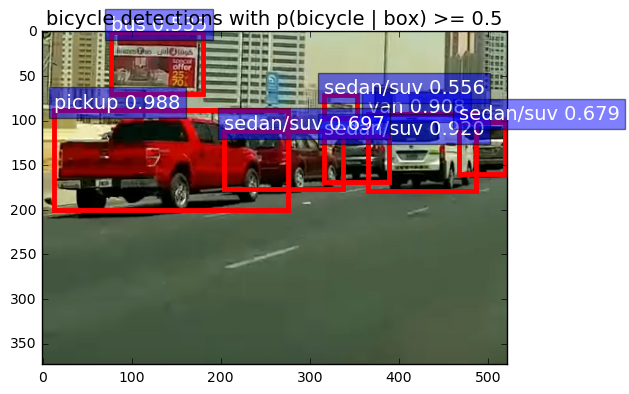

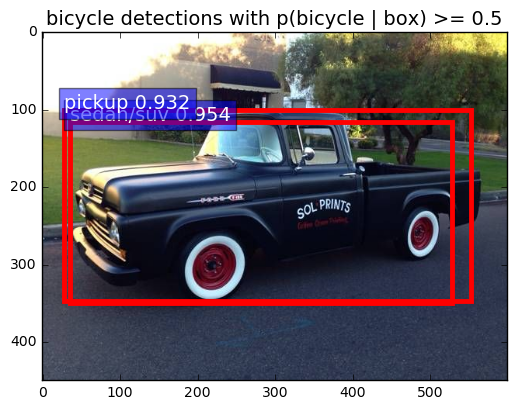

...

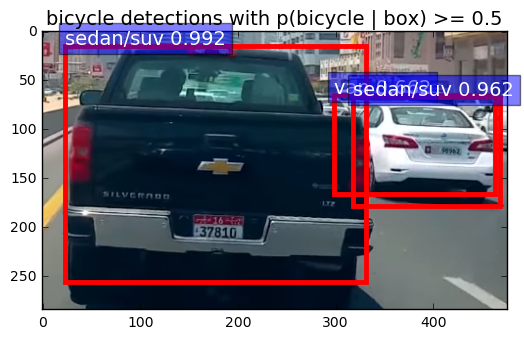

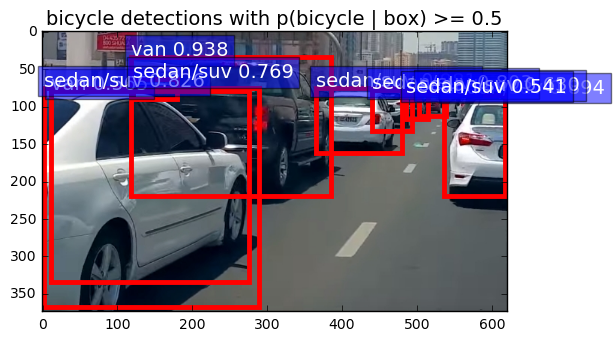

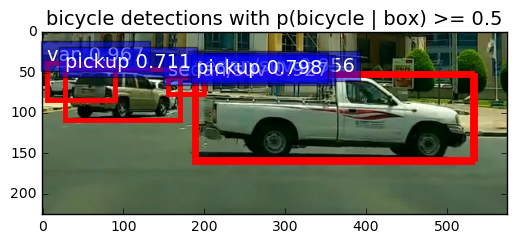

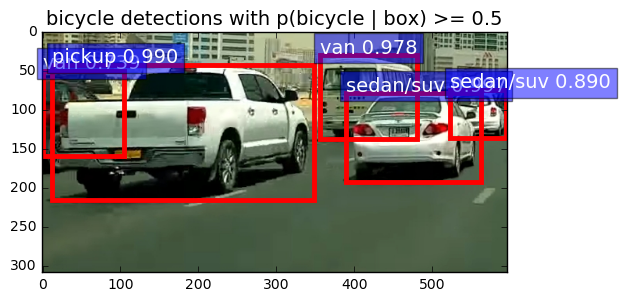

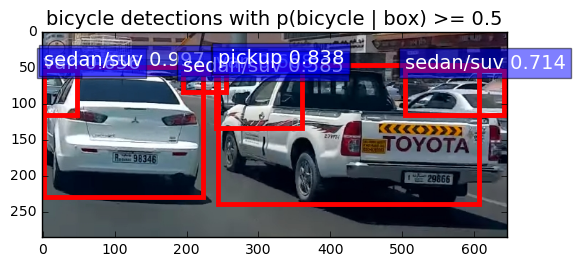

In [25]:
im_names = glob.glob("/root/data/demo/pickup_big/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S001.jpg
(539, 720, 3)
Detection took 0.053s for 200 object proposals


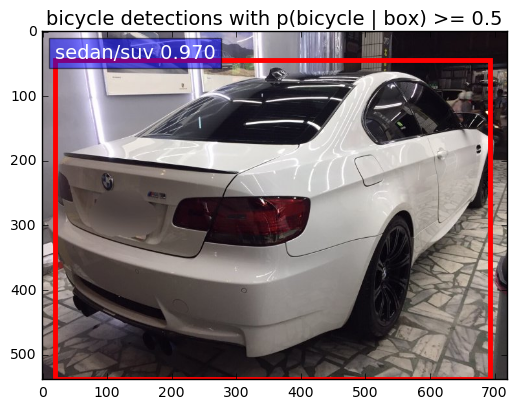

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S026.jpg
(391, 640, 3)
Detection took 0.054s for 109 object proposals


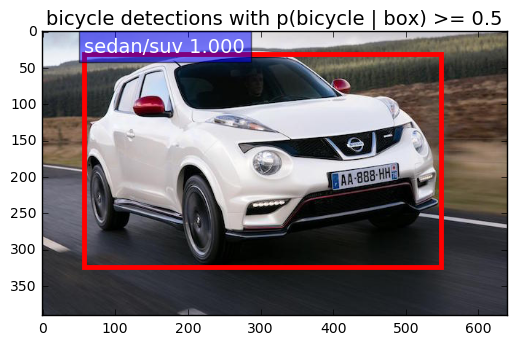

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S004.jpg
(360, 480, 3)
Detection took 0.049s for 200 object proposals


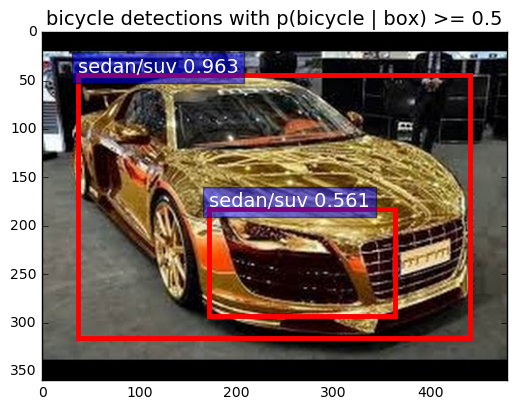

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S010.jpg
(172, 293, 3)
Detection took 0.047s for 116 object proposals


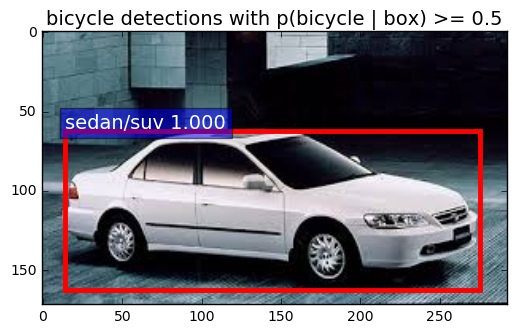

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S002.jpg
(328, 500, 3)
Detection took 0.050s for 200 object proposals


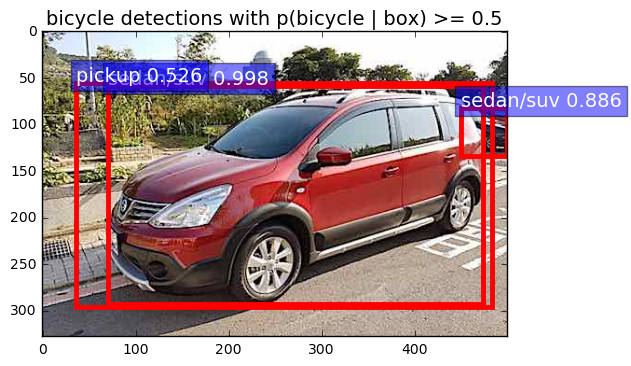

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S032.jpg
(387, 688, 3)
Detection took 0.053s for 200 object proposals


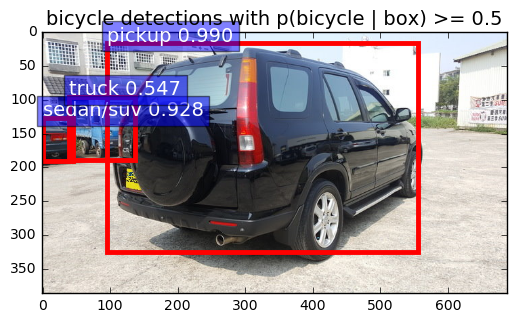

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S033.jpg
(187, 502, 3)
Detection took 0.059s for 99 object proposals


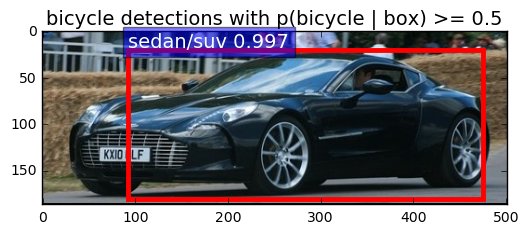

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S030.jpg
(350, 510, 3)
Detection took 0.046s for 149 object proposals


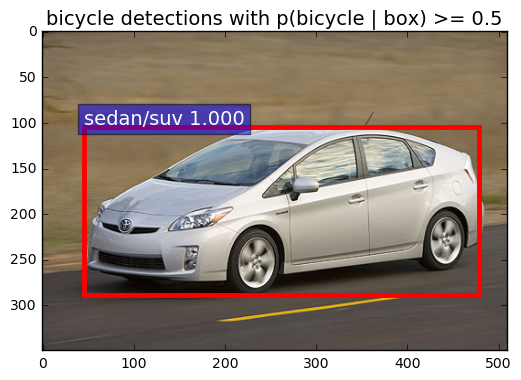

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S018.jpg
(414, 662, 3)
Detection took 0.057s for 200 object proposals


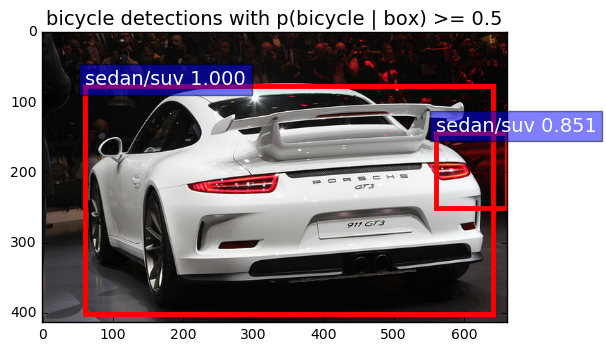

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S024.jpg
(600, 902, 3)
Detection took 0.056s for 168 object proposals


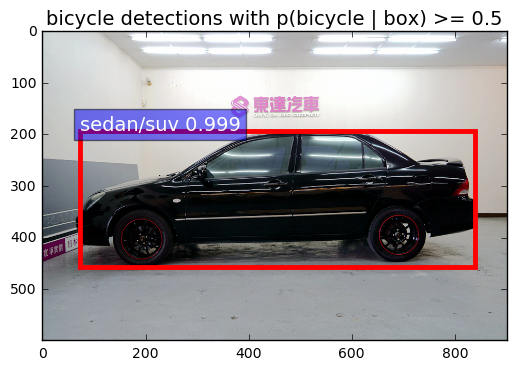

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S021.jpg
(338, 600, 3)
Detection took 0.049s for 104 object proposals


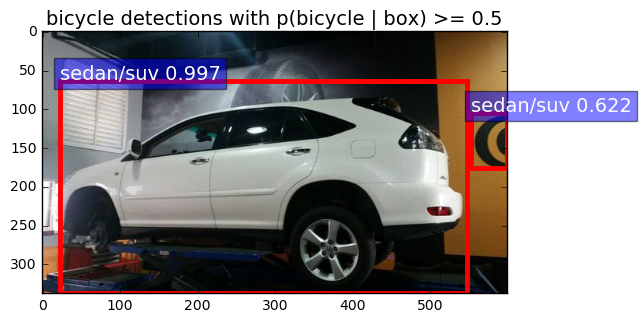

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S009.jpg
(335, 600, 3)
Detection took 0.061s for 191 object proposals


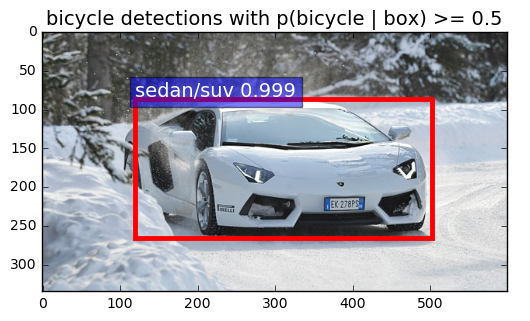

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S025.jpg
(1200, 1920, 3)
Detection took 0.099s for 124 object proposals


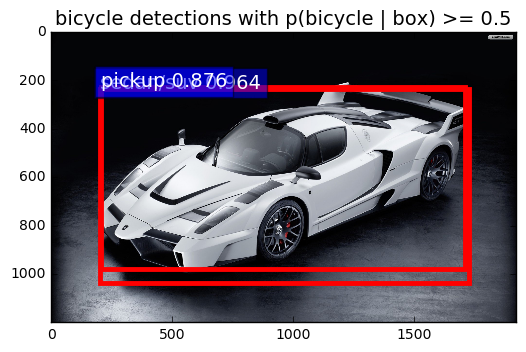

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S023.jpg
(525, 700, 3)
Detection took 0.059s for 200 object proposals


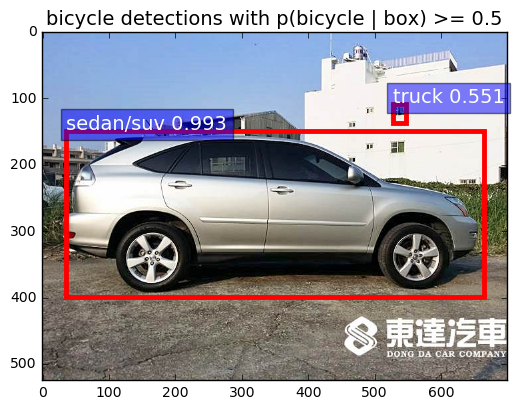

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S028.jpg
(450, 800, 3)
Detection took 0.055s for 169 object proposals


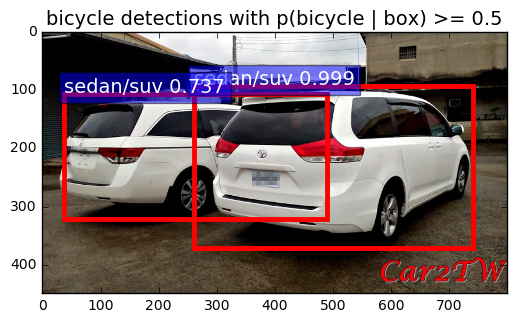

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S008.jpg
(450, 670, 3)
Detection took 0.048s for 108 object proposals


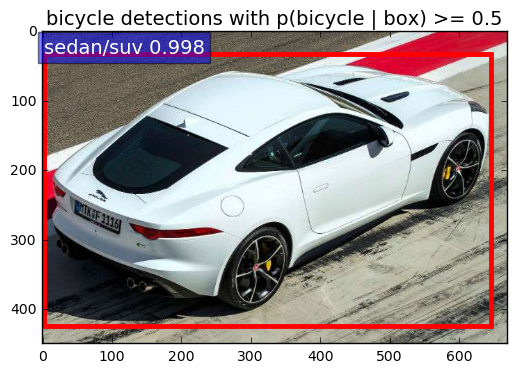

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S029.jpg
(450, 800, 3)
Detection took 0.057s for 200 object proposals


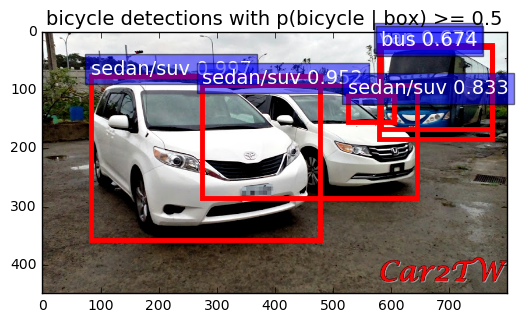

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S017.jpg
(414, 662, 3)
Detection took 0.051s for 200 object proposals


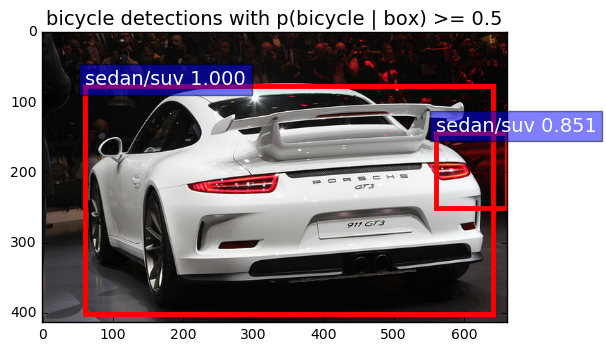

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S005.jpg
(168, 299, 3)
Detection took 0.048s for 200 object proposals


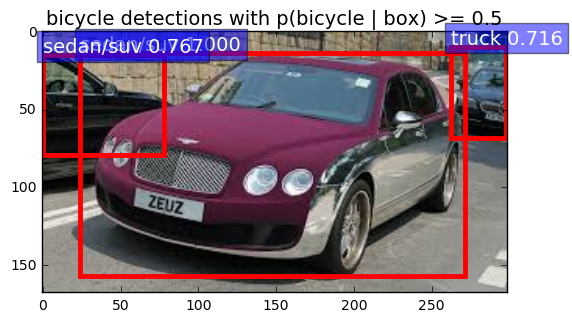

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S006.jpg
(173, 291, 3)
Detection took 0.049s for 103 object proposals


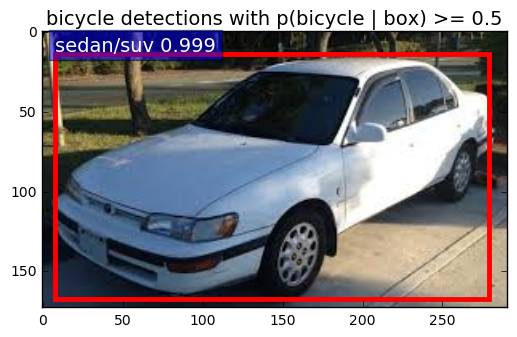

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S003.jpg
(782, 1280, 3)
Detection took 0.071s for 200 object proposals


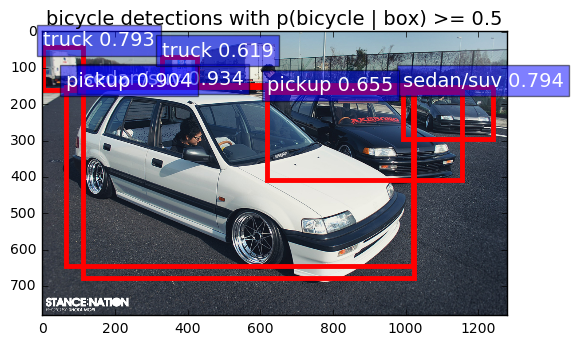

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S022.jpg
(400, 600, 3)
Detection took 0.049s for 160 object proposals


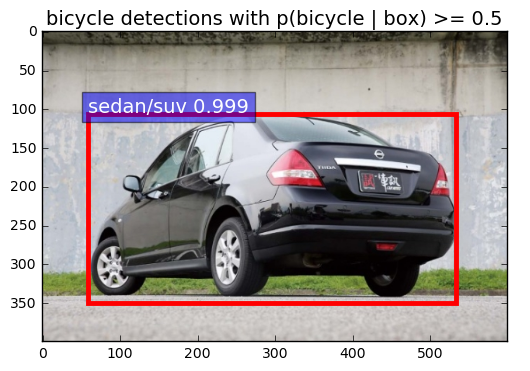

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S027.jpg
(183, 275, 3)
Detection took 0.048s for 155 object proposals


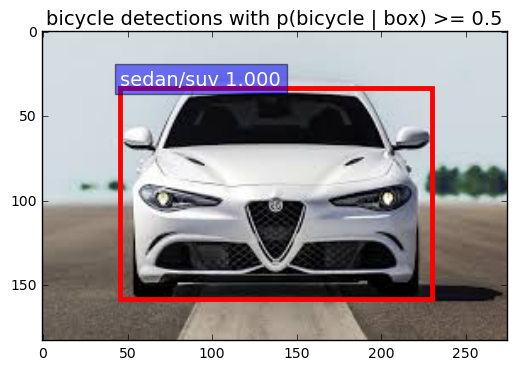

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S020.jpg
(283, 521, 3)
Detection took 0.047s for 66 object proposals


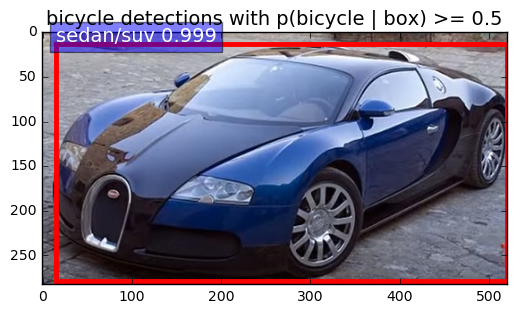

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S031.jpg
(427, 640, 3)
Detection took 0.049s for 158 object proposals


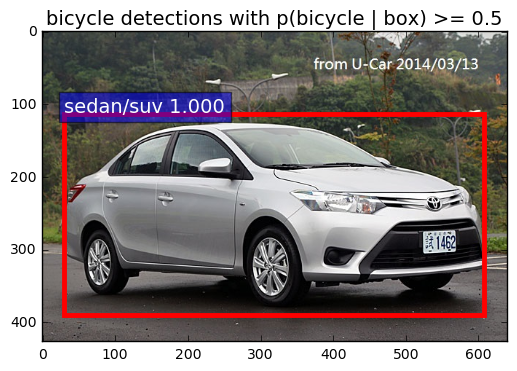

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S013.jpg
(154, 326, 3)
Detection took 0.048s for 106 object proposals


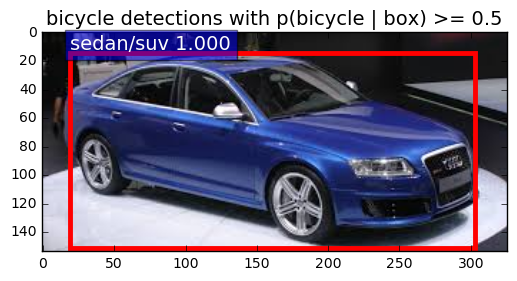

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S015.jpg
(337, 600, 3)
Detection took 0.053s for 200 object proposals


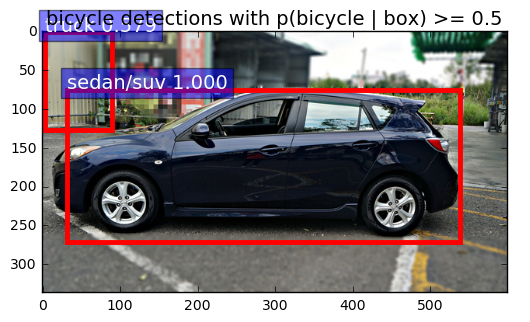

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S014.jpg
(225, 300, 3)
Detection took 0.043s for 200 object proposals


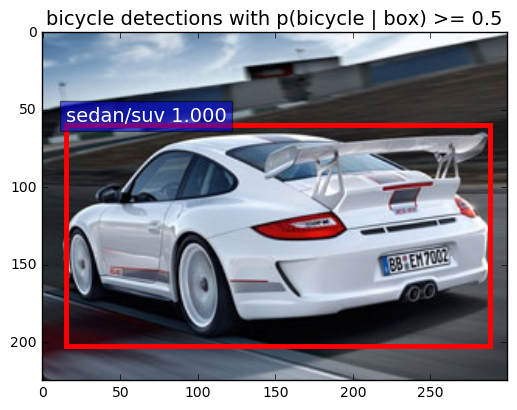

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S016.jpg
(662, 1024, 3)
Detection took 0.058s for 92 object proposals


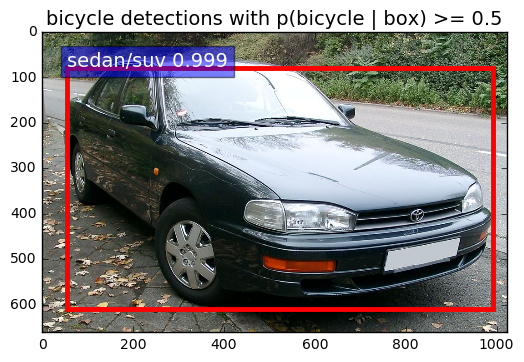

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S007.jpg
(174, 290, 3)
Detection took 0.049s for 153 object proposals


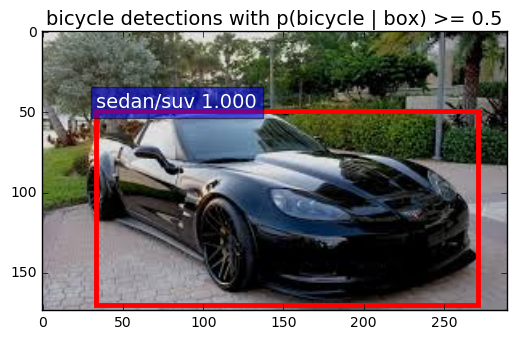

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S012.jpg
(399, 600, 3)
Detection took 0.049s for 181 object proposals


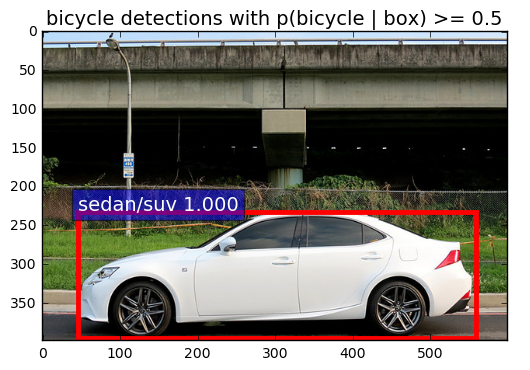

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/SUV/S011.jpg
(189, 267, 3)
Detection took 0.045s for 148 object proposals


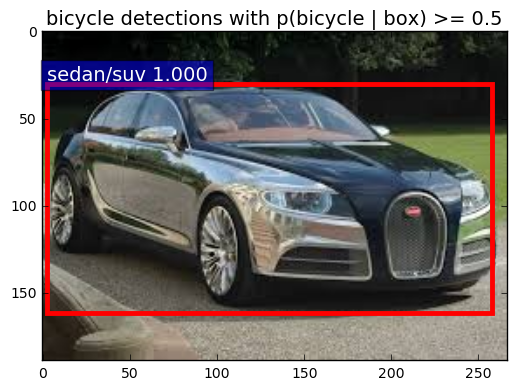

In [26]:
im_names = glob.glob("/root/data/demo/SUV/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)
    plt.show()


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_103513.jpg
(284, 712, 3)
Detection took 0.068s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_102821.jpg
(414, 947, 3)
Detection took 0.066s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_103559.jpg
(213, 643, 3)
Detection took 0.073s for 194 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/6280517930_b590ea5169_b.jpg
(769, 1024, 3)
Detection took 0.062s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_104511.jpg
(361, 557, 3)
Detection took 0.050s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/van_big/2017-09-19_102532.jpg
(328, 546, 3)
Detection took 0.049s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~

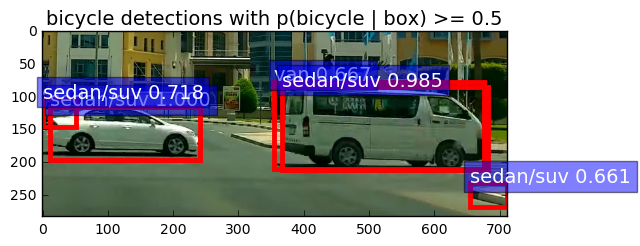

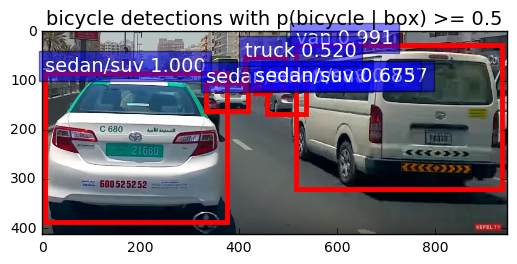

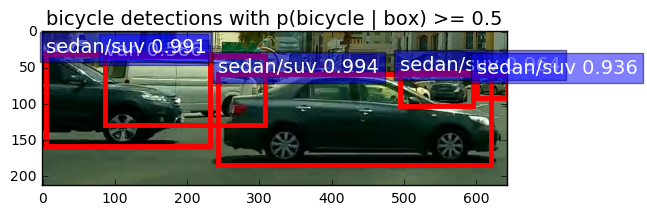

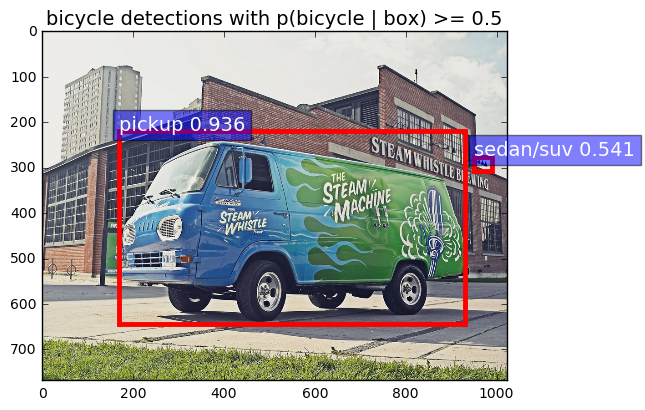

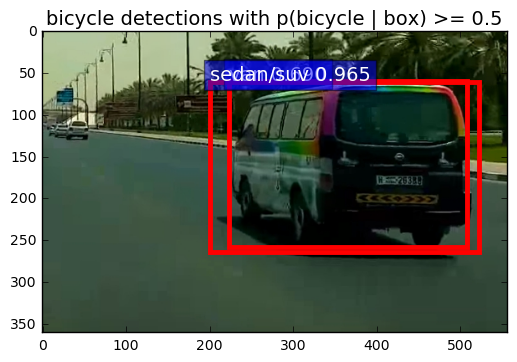

...

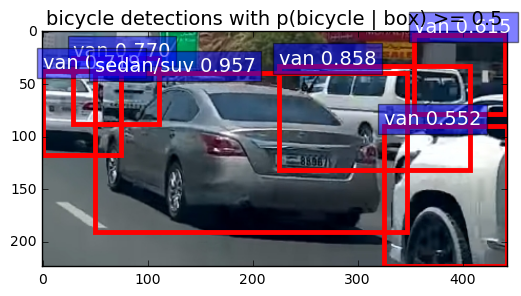

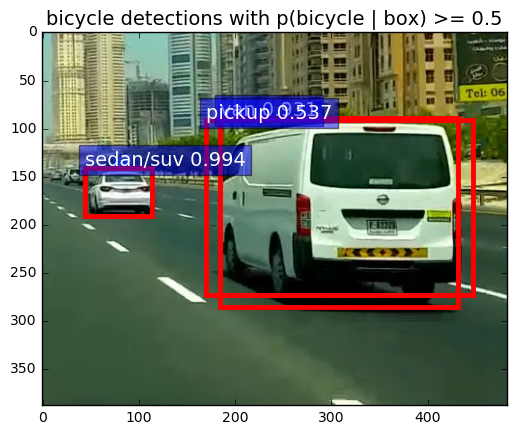

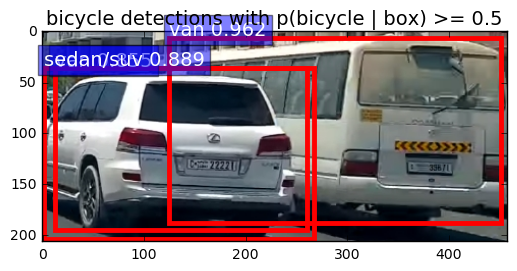

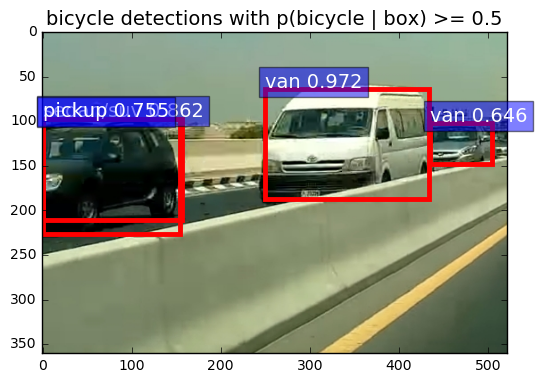

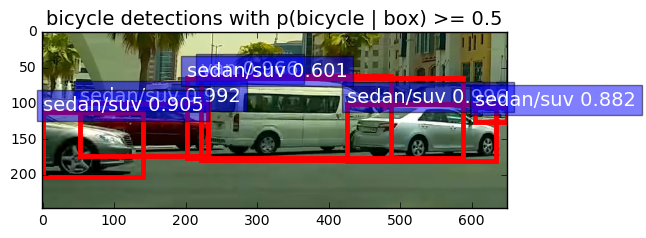

In [28]:
im_names = glob.glob("/root/data/demo/van_big/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_110921.jpg
(346, 534, 3)
Detection took 0.052s for 160 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_111236.jpg
(548, 632, 3)
Detection took 0.049s for 178 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/maxresdefault.jpg
(1080, 1920, 3)
Detection took 0.120s for 101 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_110932.jpg
(396, 582, 3)
Detection took 0.048s for 167 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_111307.jpg
(273, 323, 3)
Detection took 0.046s for 155 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo//root/data/demo/Van-1018/2017-10-18_111151.jpg
(335, 509, 3)
Detection took 0.050s for 200 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~

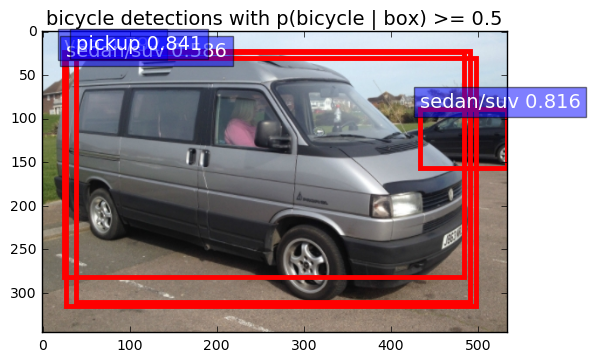

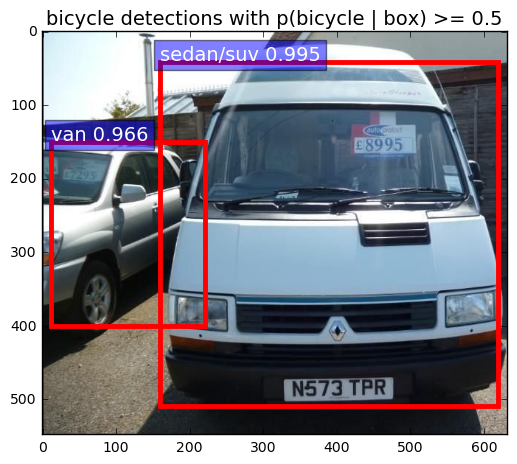

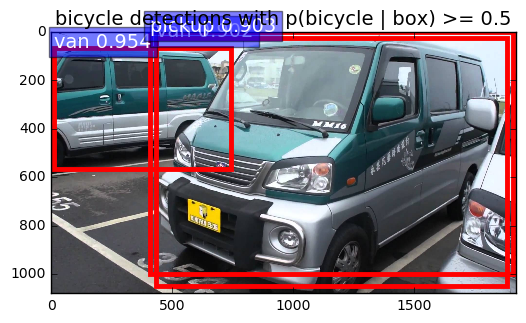

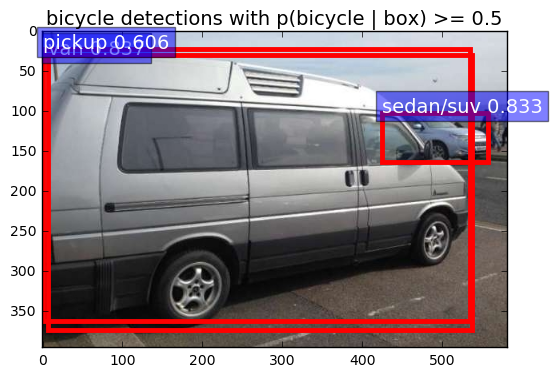

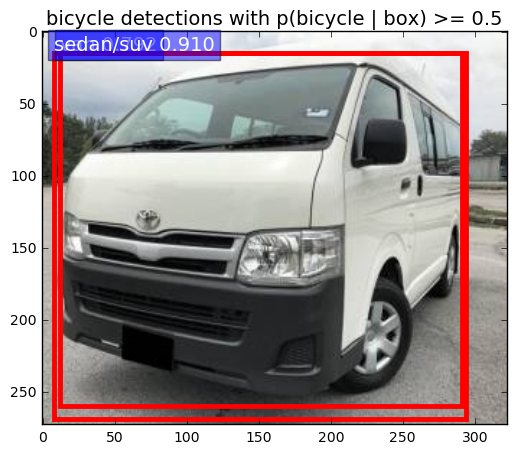

...

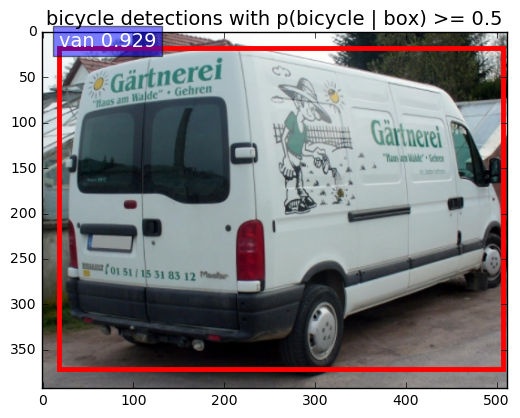

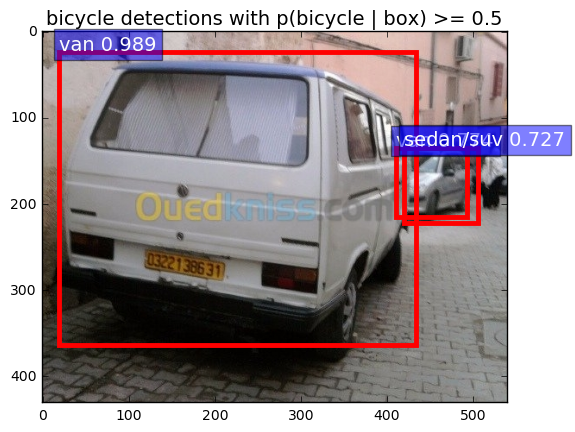

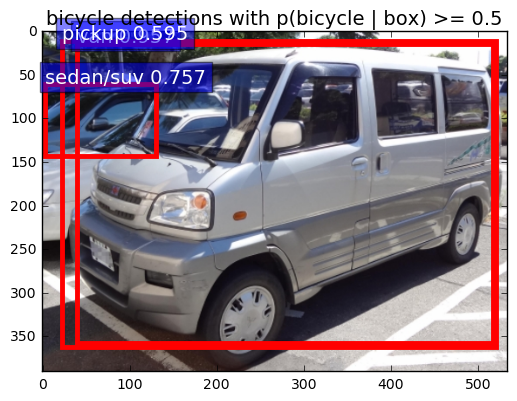

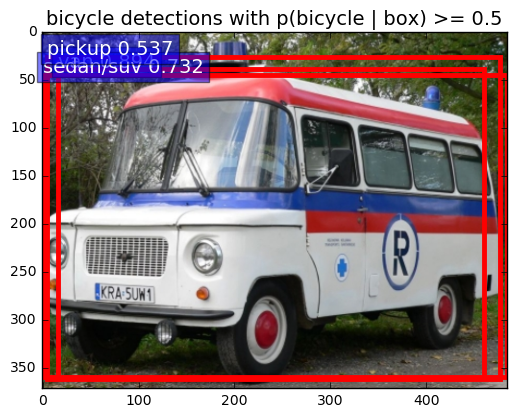

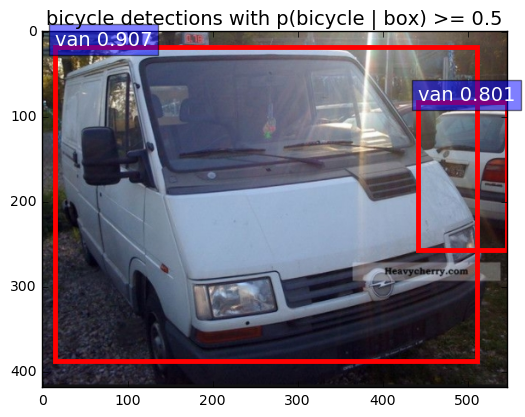

In [27]:
im_names = glob.glob("/root/data/demo/Van-1018/*.jpg")
for im_name in im_names:
    print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
    print 'Demo for data/demo/{}'.format(im_name)
    demo(net, im_name)

plt.show()